In [30]:
#libreria para crear mapas
import folium
from folium import features
#libreria para datos json
import json
#Libreria para graficar datos json en html
import vincent
from vincent import Bar
vincent.core.initialize_notebook()
#Libreria para leer informacion shapefile
import geopandas as gpd
#libreria para tratar con datos tabulares
import pandas as pd
#libreria para graficos
import matplotlib.pylab as plt

%config Completer.use_jedi = False #for auto complete code 

Creamos el mapa centrado en coordenadas WGC 84 -11.98652, -75.69976.

In [2]:
m = folium.Map(location=[-11.98652, -75.69976], zoom_start=5)

In [3]:
m

In [4]:
#Shapefile de vertientes
gdf=gpd.read_file('../data/shp/vertientes/ver_pacifico.shp')

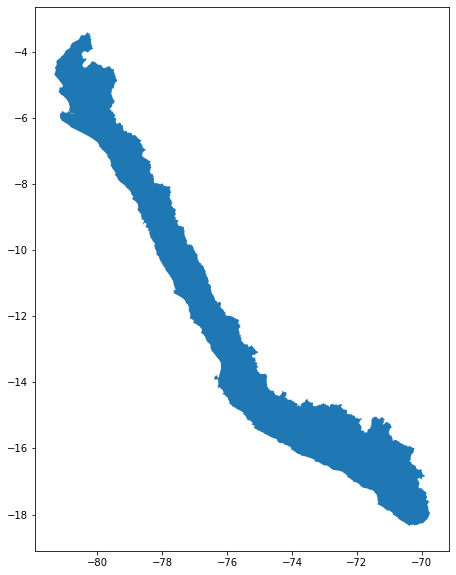

In [5]:
gdf.plot(figsize=(15,10))
plt.show()

In [6]:
folium.GeoJson(data=gdf["geometry"]).add_to(m)

In [7]:
m

In [8]:
folium.LayerControl().add_to(m)

In [9]:
m

### Datos de precipitación

In [10]:
datos=pd.read_csv('../data/Estaciones/Huarpa_diario.csv')
datos.set_index('date', inplace=True)

In [11]:
datos.head()

,San Miguel,Hacienda Cochas,La Quinua,Wayllapampa,Huamanga,Allpachaca
date,,,,,,
1981-01-01,1.58,2.13,1.80,0.96,0.78,0.00
1981-01-02,0.00,0.00,0.86,3.12,2.72,0.55
1981-01-03,3.29,4.38,3.07,1.14,0.89,0.00
1981-01-04,0.00,0.00,0.00,0.00,0.85,1.58
1981-01-05,2.38,3.22,4.08,6.90,6.37,2.74


In [47]:
ubicacion=pd.read_csv('../data/Estaciones/Huarpa.estaciones.csv',sep=';')
ubicacion.head()

,Estacion,x,y,Alt
0,San Miguel,-73.98333,-13.01667,3323
1,Hacienda Cochas,-73.88333,-13.03333,3323
2,La Quinua,-74.14139,-13.05528,3240
3,Wayllapampa,-74.21667,-13.07639,2470
4,Huamanga,-74.23694,-13.15000,2761


In [54]:
for i,estaciones in enumerate(datos.columns):
    line = vincent.Line(datos[estaciones].to_list(), height=100, width=200)
    data=json.loads(line.to_json())
    v=features.Vega(data, width="100%", height="100%")
    p = folium.Popup(estaciones)
    mk=features.Marker([ubicacion.y[i],ubicacion.x[i]])
    mk.add_child(p)
    p.add_child(v)
    m.add_child(mk)

In [55]:
m